In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np
import os
import scvi

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

Global seed set to 0


In [2]:
DIR2LOAD = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/subpopulations/Myeloid/"
)

In [3]:
DIR2SAVE = DIR2LOAD.joinpath("final/")
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [4]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [5]:
adata = sc.read_h5ad(
    DIR2LOAD.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Myeloid_clustering.h5ad"
    )
)

In [6]:
set(adata.obs.Annotation_scVI_detailed)

{'B-Myeloid doublet',
 'C1QC Mac',
 'Epithelial contamination',
 'FCGR3A Mono',
 'FCN1 Mono',
 'HSP',
 'HSP Mono',
 'IL1B Mac',
 'Myeloid cycling',
 'Myeloid-T doublet',
 'NLRP3 Mac',
 'Neutrophil',
 'PLTP LYVE1 Mac',
 'SPP1 Mac',
 'cDC1',
 'cDC2',
 'migDC',
 'pDC'}

### Remove problem clusters 

In [7]:
set(
    adata[
        ~adata.obs.Annotation_scVI_detailed.isin(
            [
                "B-Myeloid doublet",
                "Epithelial contamination",
                "HSP",
                "Myeloid-T doublet",
            ]
        )
    ].obs.Annotation_scVI_detailed
)

{'C1QC Mac',
 'FCGR3A Mono',
 'FCN1 Mono',
 'HSP Mono',
 'IL1B Mac',
 'Myeloid cycling',
 'NLRP3 Mac',
 'Neutrophil',
 'PLTP LYVE1 Mac',
 'SPP1 Mac',
 'cDC1',
 'cDC2',
 'migDC',
 'pDC'}

In [8]:
adata = adata[
    ~adata.obs.Annotation_scVI_detailed.isin(
        ["B-Myeloid doublet", "Epithelial contamination", "HSP", "Myeloid-T doublet"]
    )
].copy()

In [9]:
adata.obs.Annotation_scVI_detailed.value_counts()

SPP1 Mac           7017
C1QC Mac           6449
FCN1 Mono          4685
FCGR3A Mono        2697
cDC2               2664
Myeloid cycling    2166
PLTP LYVE1 Mac     2150
NLRP3 Mac          1887
HSP Mono           1755
IL1B Mac           1457
pDC                1423
migDC              1159
Neutrophil         1054
cDC1                343
Name: Annotation_scVI_detailed, dtype: int64

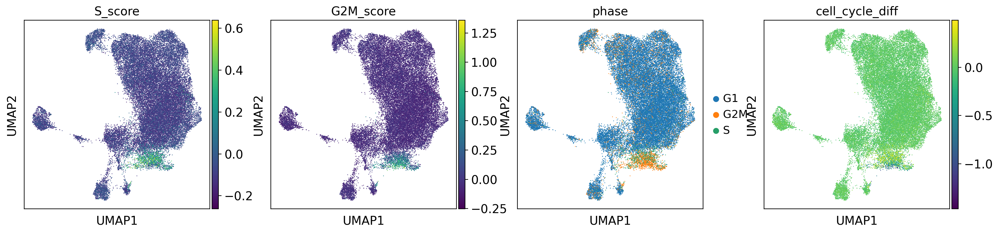

In [10]:
sc.pl.umap(
    adata,
    color=["S_score", "G2M_score", "phase", "cell_cycle_diff"],
    color_map="viridis",
    save="cell_cycle.pdf",
)

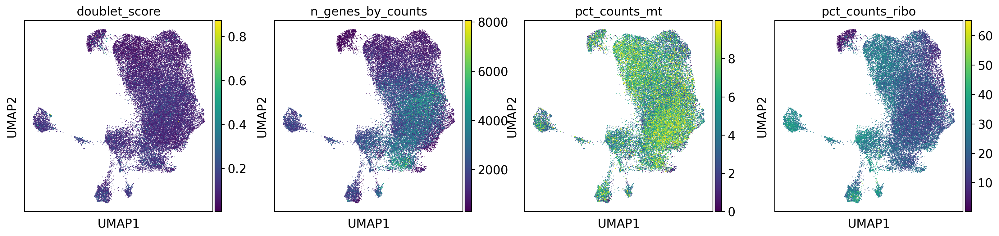

In [11]:
sc.pl.umap(
    adata,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

### Look at distribution of cell source across clusters 

In [12]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, colors: dict, figname: str
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        sharey=False,
        sharex=False,
        dpi=DPI,
    )  # figsize=(4, 4))

    print(table2plot)
    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors
    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())
    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]
    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(FIG2SAVE.joinpath(figname), dpi=DPI, format="pdf", bbox_inches="tight")
    plt.show()

cell_source        SMC       KUL      Pelka        Che         Wu
leiden_scVI                                                      
0             8.287947  3.883495  62.846318  14.563107  10.419133
1            13.219160  1.605566  38.774418  37.008295   9.392561
2            10.146225  2.029245  64.249478  17.069531   6.505521
4            27.666428  1.145311  54.223336   6.692913  10.272011
5            11.504425  2.212389  76.364307   6.415929   3.502950
6             5.895439  2.558398  77.011494  11.197627   3.337041
7            12.307692  2.411642  48.981289  32.515593   3.783784
8             9.095106  0.692521  67.728532  13.804247   8.679594
9             3.813953  8.139535  72.465116  12.465116   3.116279
10           39.268680  1.377848  25.543190  25.861155   7.949126
11           44.045584  0.797721  24.330484  13.789174  17.037037
12           49.347975  0.754976  31.434454  13.932739   4.529856
13           18.973999  0.843289  57.273366  21.152495   1.756852
14        

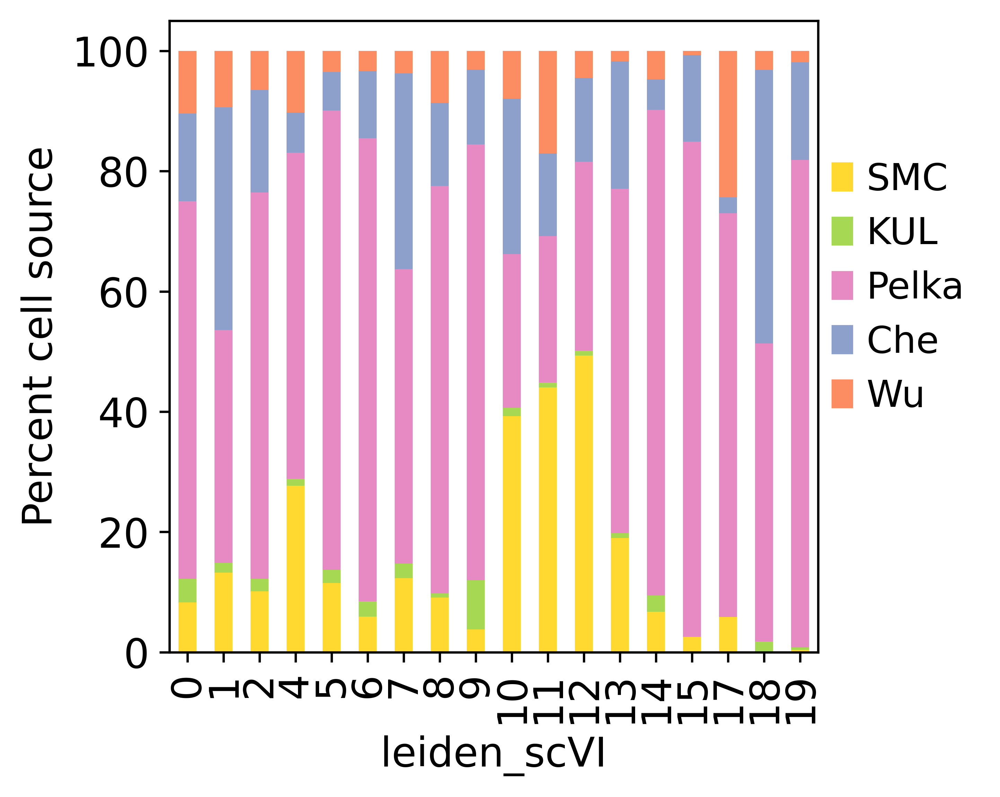

In [13]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["cell_source"].cat.categories.values.tolist(),
        adata.uns["cell_source_colors"],
    )
)

proportion_cells_patient(
    adata.obs,
    groupby_labels=["leiden_scVI", "cell_source"],
    xlabel="leiden_scVI",
    ylabel="Percent cell source",
    colors=color_dict,
    figname="leiden_cell_source.pdf",
)

In [14]:
markers_myeloid_general = {
    "Macrophage": ["APOC1", "C1QC", "APOE", "FCER1G", "CD163"],
    "Monocyte": ["S100A8", "S100A9", "VCAN", "FCN1"],
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A"],
    "Neutrophil": ["FCGR3B", "S100A8", "S100A12"],
    "Cycling": ["MKI67"],
}

markers_macrophage = {
    "Macrophage": ["APOC1", "C1QC", "APOE", "FCER1G", "CD163"],
    "MHCII": [
        "HLA-DRA",
        "HLA-DRB1",
        "HLA-DRB5",
        "HLA-A",
        "HLA-C",
        "HLA-DQA1",
        "HLA-DQB1",
        "HLA-DPA1",
    ],
    "PLTP LYVE1": ["PLTP", "LYVE1"],
    "SPP1": ["SPP1", "VEGFA", "MARCO", "FN1", "SLC11A1", "IL1RN"],
    "C1QC": ["C1QC", "FPR3", "TREM2", "MS4A4A", "SLAMF8", "FCGR1A"],
    "NLRP3/IL1B": ["NLRP3", "EREG", "IL1B", "CCL3"],
}

markers_monocyte = {
    "Monocyte": ["S100A8", "S100A9", "VCAN", "FCN1"],
    "CD14": ["CD14"],
    "CD16": ["FCGR3A"],
    "FCN1": ["FCN1"],
}

DC_markers = {
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A"],
    "cDC1": ["CLEC9A", "XCR1", "BATF3", "RAB7B", "CADM1"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A", "MSLN", "JAML"],
    "DC3": ["CLEC10A", "S100A8", "CD36", "CD163"],
    "pDC": ["IL3RA", "LILRA4", "PLD4", "JCHAIN", "IL3RA", "SPIB", "MZB1", "IRF7"],
    "migDC": ["LAMP3", "CCR7"],
}

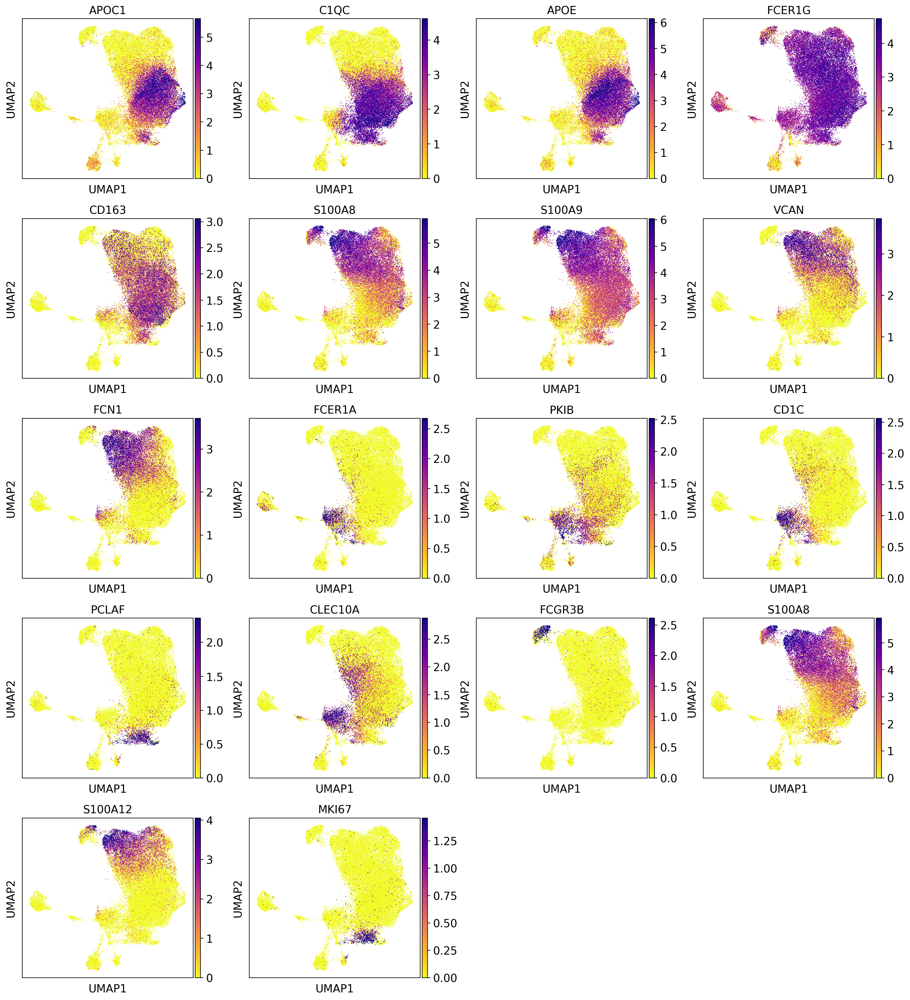

In [16]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers_myeloid_general.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

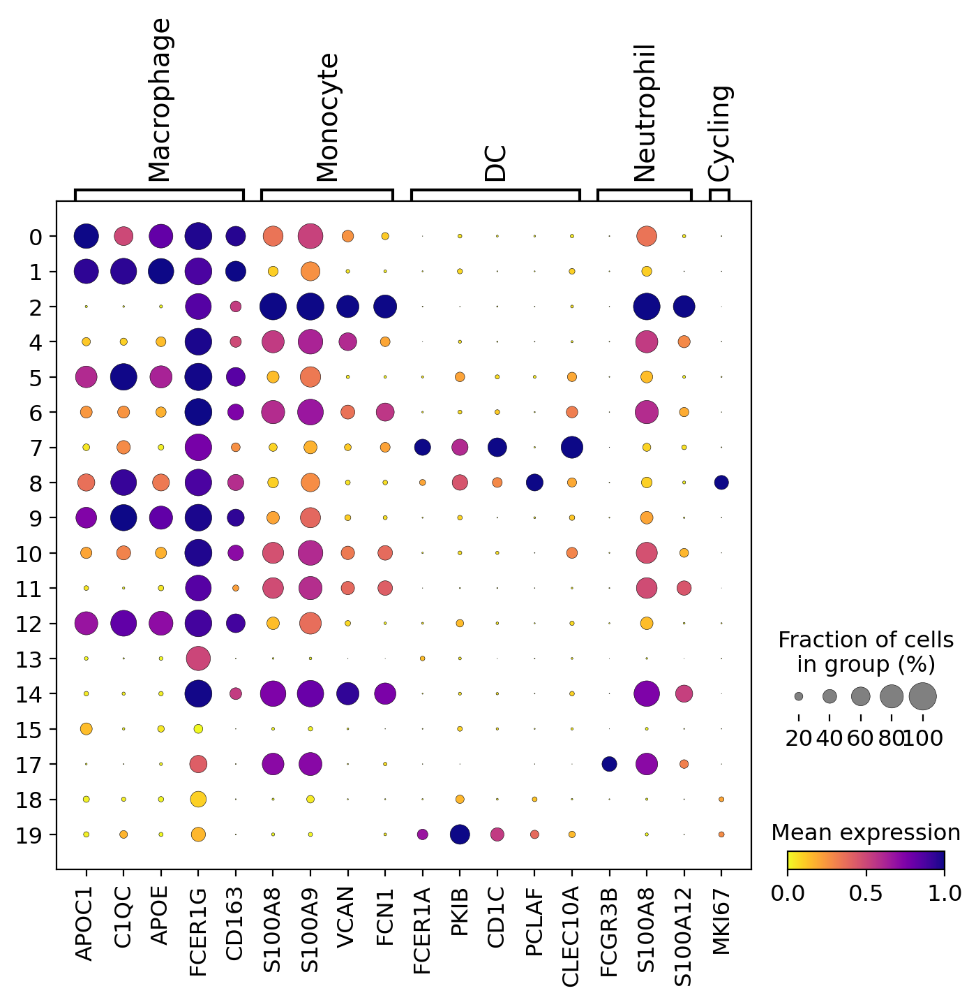

In [17]:
sc.pl.dotplot(
    adata,
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_myeloid_general,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general.pdf",
    show=True,
)

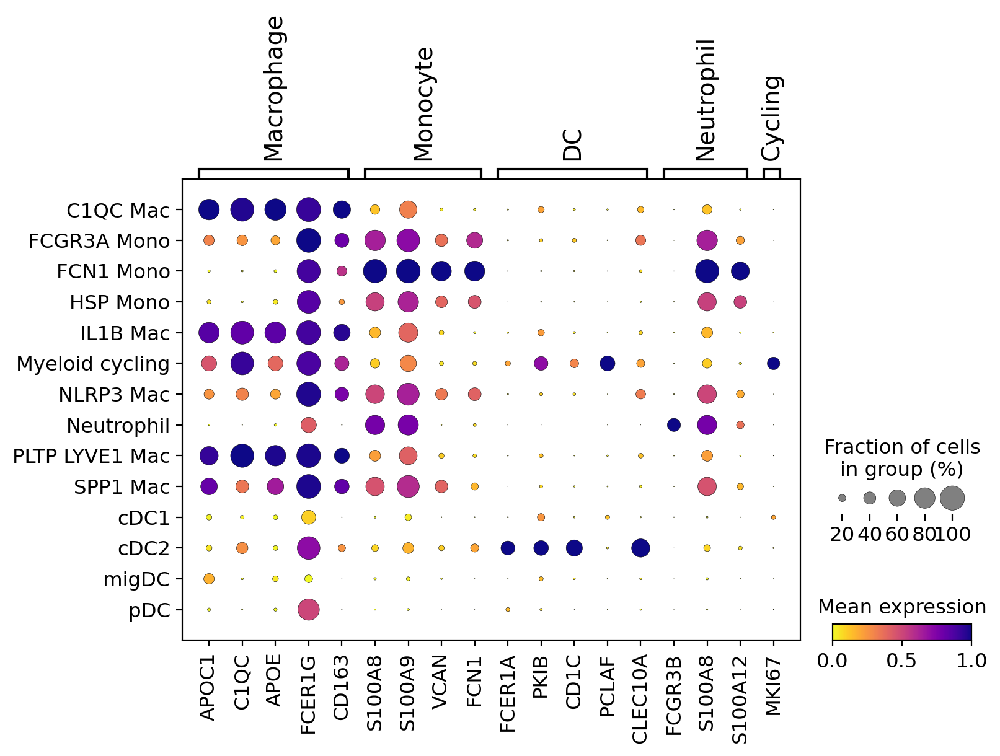

In [18]:
sc.pl.dotplot(
    adata,
    groupby="Annotation_scVI_detailed",
    use_raw=True,
    var_names=markers_myeloid_general,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_annotation.pdf",
    show=True,
)

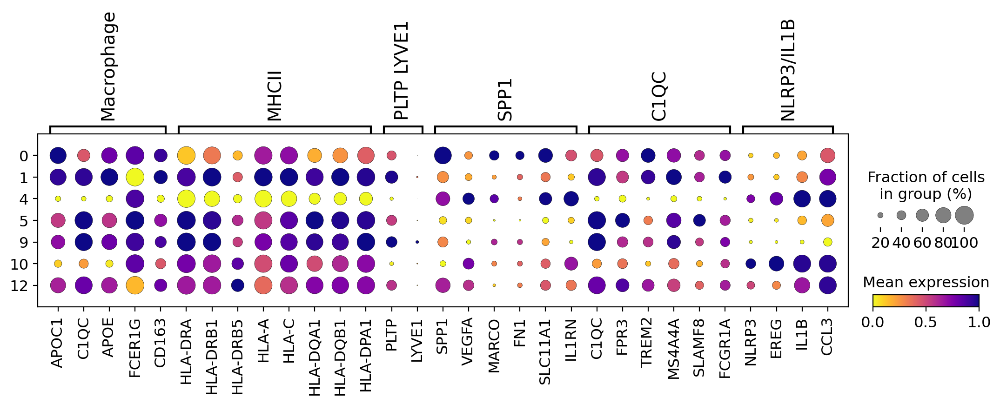

In [19]:
sc.pl.dotplot(
    adata[adata.obs.Annotation_scVI_detailed.str.contains("Mac")],
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_macrophage,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_mac.pdf",
    show=True,
)

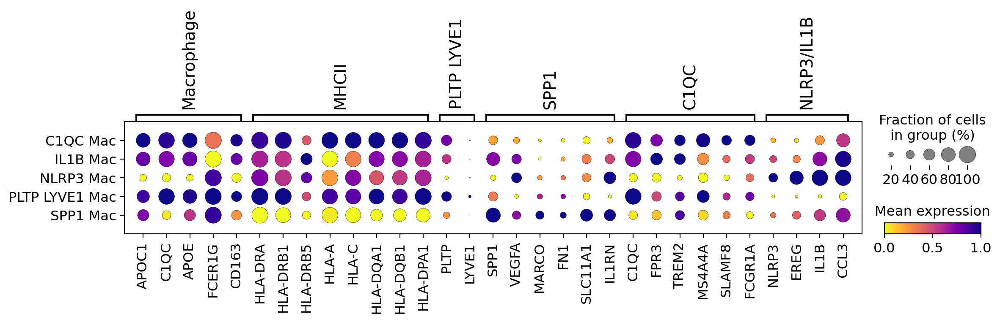

In [20]:
sc.pl.dotplot(
    adata[adata.obs.Annotation_scVI_detailed.str.contains("Mac")],
    groupby="Annotation_scVI_detailed",
    use_raw=True,
    var_names=markers_macrophage,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_mac_annotation.pdf",
    show=True,
)

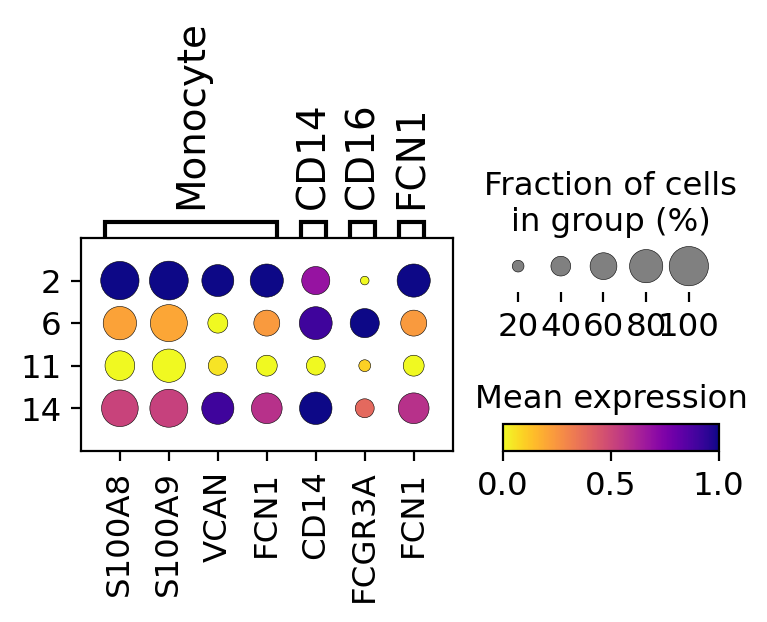

In [21]:
sc.pl.dotplot(
    adata[adata.obs.Annotation_scVI_detailed.str.contains("Mono")],
    groupby="leiden_scVI",
    use_raw=True,
    var_names=markers_monocyte,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_mono.pdf",
    show=True,
)

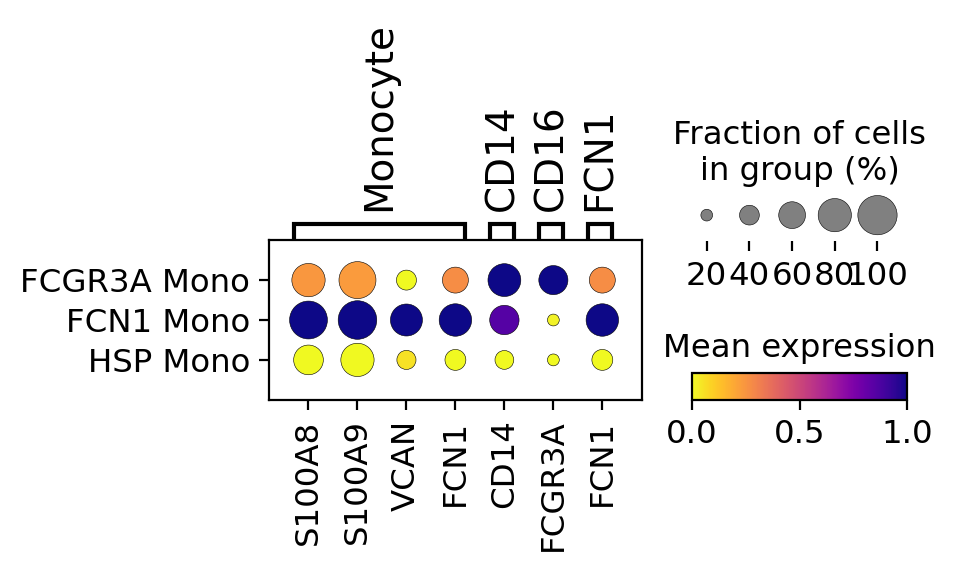

In [22]:
sc.pl.dotplot(
    adata[adata.obs.Annotation_scVI_detailed.str.contains("Mono")],
    groupby="Annotation_scVI_detailed",
    use_raw=True,
    var_names=markers_monocyte,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_mono_annotation.pdf",
    show=True,
)

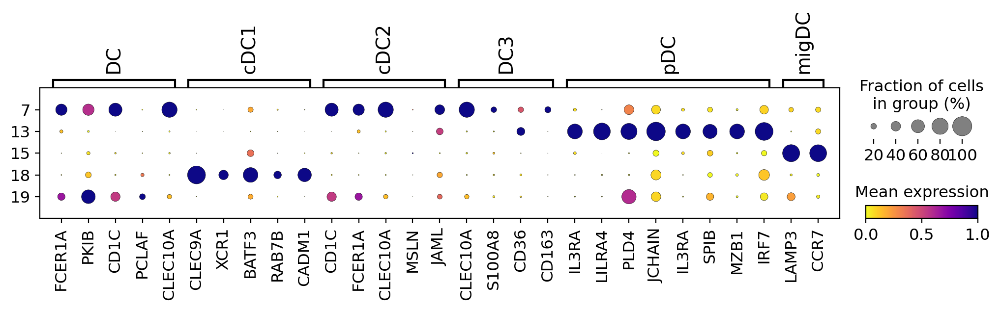

In [23]:
sc.pl.dotplot(
    adata[adata.obs.Annotation_scVI_detailed.str.contains("DC")],
    groupby="leiden_scVI",
    use_raw=True,
    var_names=DC_markers,
    cmap="plasma_r",
    standard_scale="var",
    vmin=0,
    vmax=1,
    colorbar_title="Mean expression",
    dendrogram=False,
    save="myeloid_dotplot_mean_general_DC.pdf",
    show=True,
)

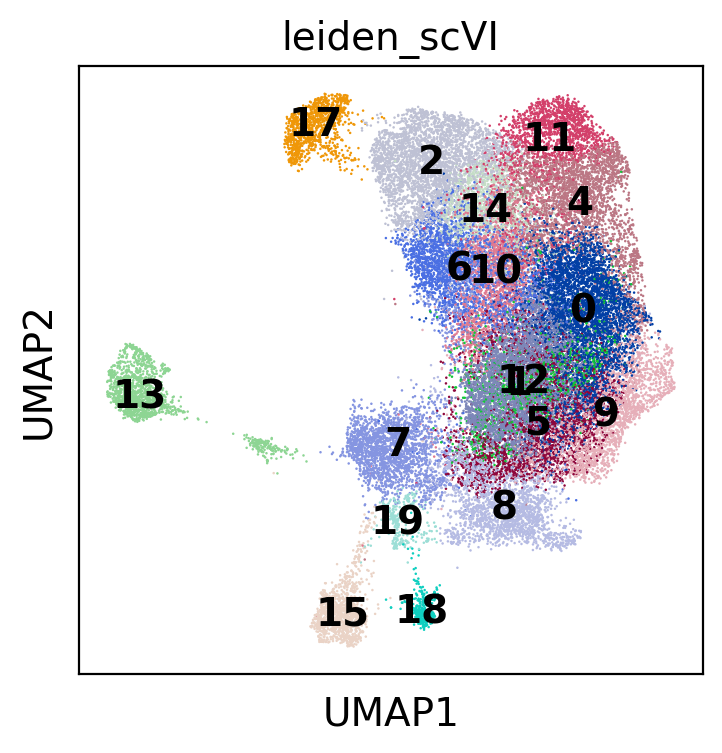

In [24]:
sc.pl.umap(adata, color="leiden_scVI", show=True, legend_loc="on data")

### Change colours to match metastasis

In [25]:
# set colours for dataset, need to know order
adata.obs.Annotation_scVI_detailed.cat.categories.values.tolist()

['C1QC Mac',
 'FCGR3A Mono',
 'FCN1 Mono',
 'HSP Mono',
 'IL1B Mac',
 'Myeloid cycling',
 'NLRP3 Mac',
 'Neutrophil',
 'PLTP LYVE1 Mac',
 'SPP1 Mac',
 'cDC1',
 'cDC2',
 'migDC',
 'pDC']

* C1QC : #80b1d3
* FCGR3A: #e5d8bd
* FCN1 Mono: #b3de69
* IL1B Mac: #fb8072
* Myeloid cycling: #ffff99
* NLRP3 Mac: #fdb462
* Neutrophil: #1f78b4
* PLTP LYEV1 Mac: #fccde5
* SPP1 Mac: #8dd3c7
* cDC1: #bc80bd
* cDC2: #bebada
* migDC: #762a83
* pDC: #fa9fb5

In [26]:
adata.uns["Annotation_scVI_detailed_colors"] = [
    "#80b1d3",
    "#e5d8bd",
    "#b3de69",
    "#e31a1c",
    "#fb8072",
    "#ffff99",
    "#fdb462",
    "#1f78b4",
    "#fccde5",
    "#8dd3c7",
    "#bc80bd",
    "#bebada",
    "#762a83",
    "#fa9fb5",
]

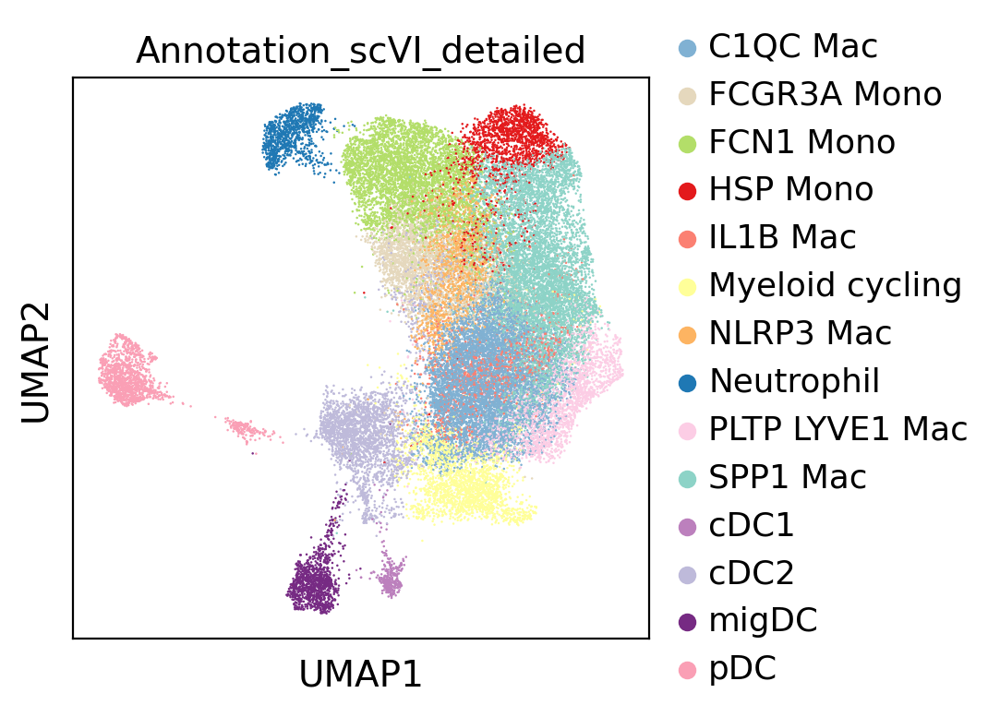

In [27]:
sc.pl.umap(
    adata,
    color="Annotation_scVI_detailed",
    show=True,
    legend_loc="right margin",
    save="Annotations.pdf",
)

In [28]:
# write to file
adata.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Myeloid_final.h5ad")
)

In [5]:
adata = sc.read_h5ad(DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Myeloid_final.h5ad"))

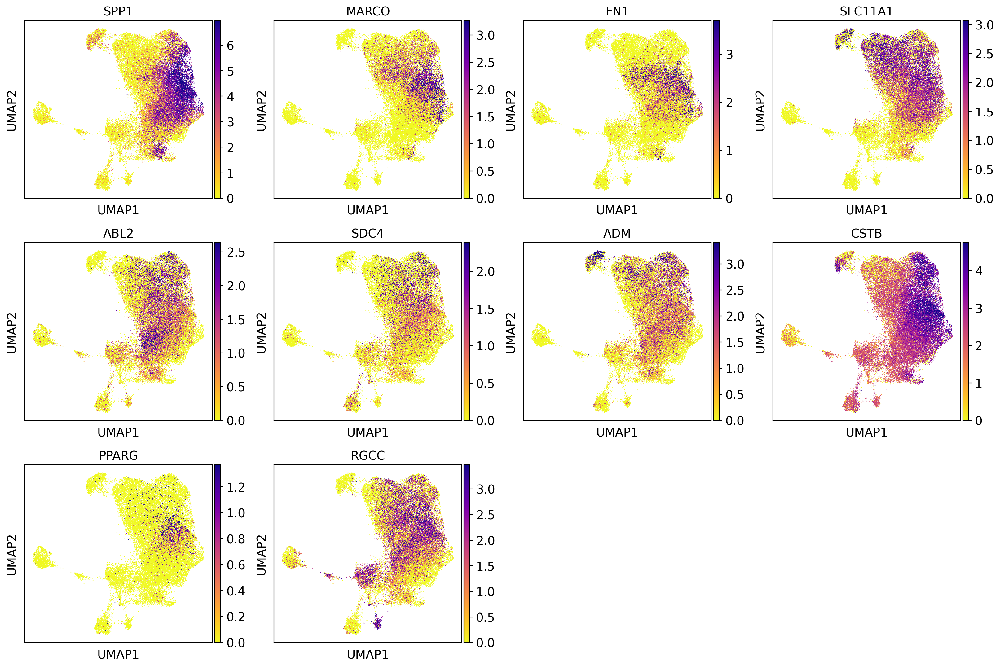

In [6]:
sc.pl.umap(
    adata,
    color=[
        "SPP1",
        "MARCO",
        "FN1",
        "SLC11A1",
        "ABL2",
        "SDC4",
        "ADM",
        "CSTB",
        "PPARG",
        "RGCC",
    ],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
    save="SPP1_markers.pdf",
)  # SPP1

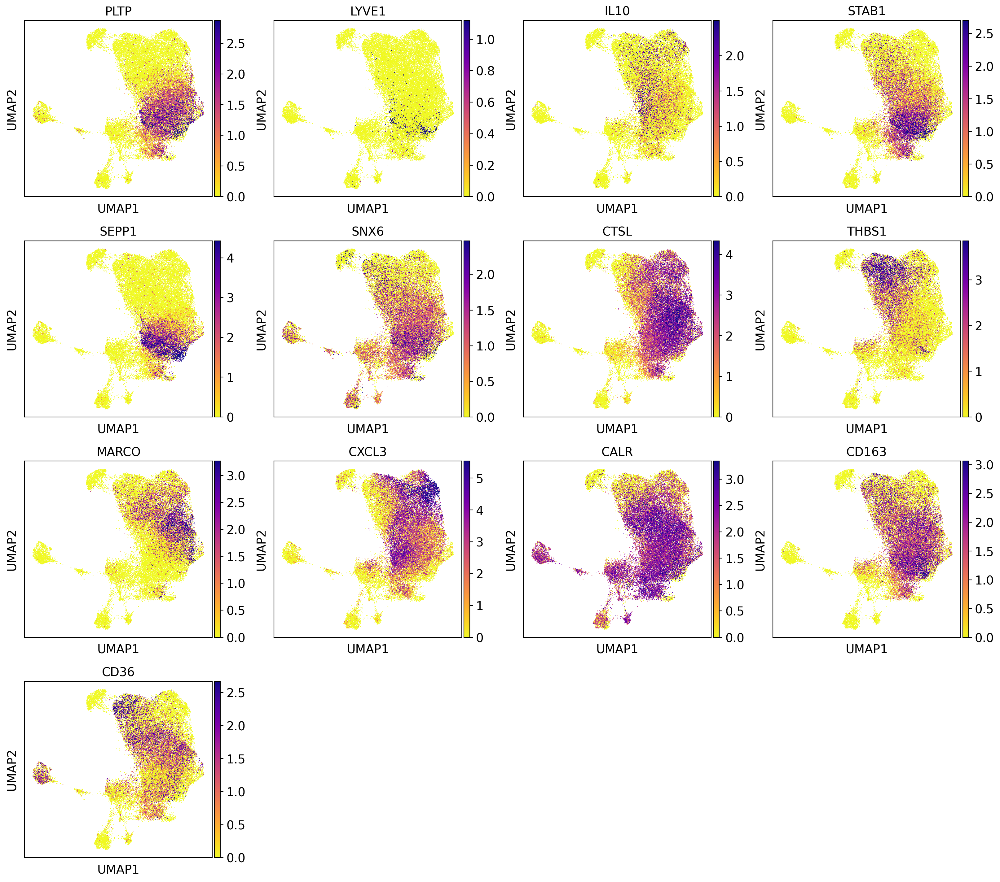

In [7]:
sc.pl.umap(
    adata,
    color=[
        "PLTP",
        "LYVE1",
        "IL10",
        "STAB1",
        "SEPP1",
        "SNX6",
        "CTSL",
        "THBS1",
        "MARCO",
        "CXCL3",
        "CALR",
        "CD163",
        "CD36",
    ],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
    save="PLTP_markers.pdf",
)  # PLTP Mac

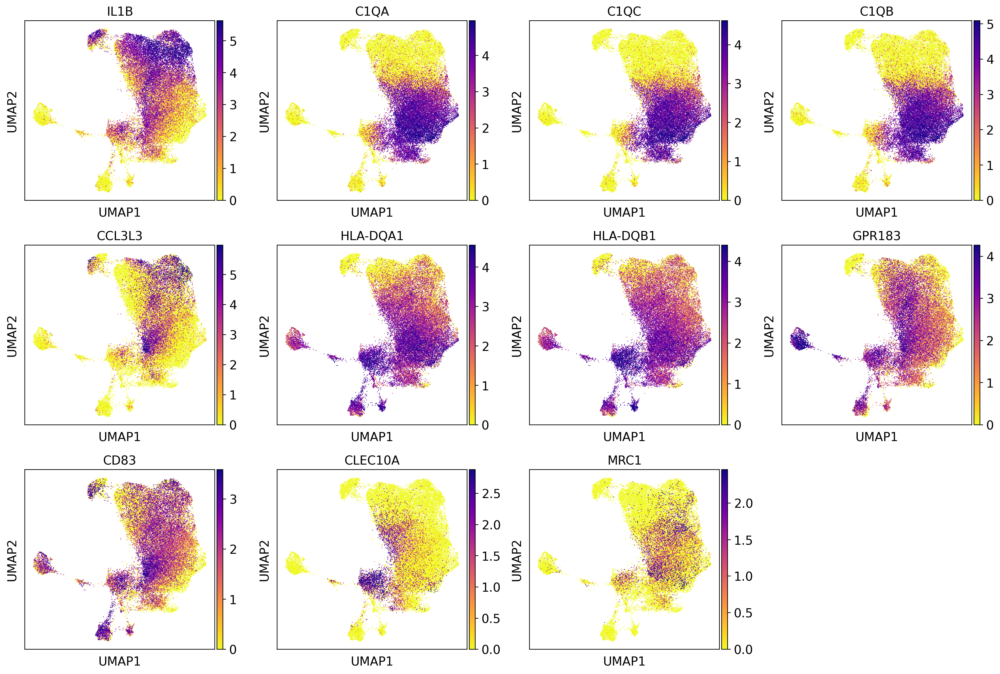

In [8]:
sc.pl.umap(
    adata,
    color=[
        "IL1B",
        "C1QA",
        "C1QC",
        "C1QB",
        "CCL3L3",
        "HLA-DQA1",
        "HLA-DQB1",
        "GPR183",
        "CD83",
        "CLEC10A",
        "MRC1",
    ],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
    save="IL1B_markers.pdf",
)  # IL1B signature zhang

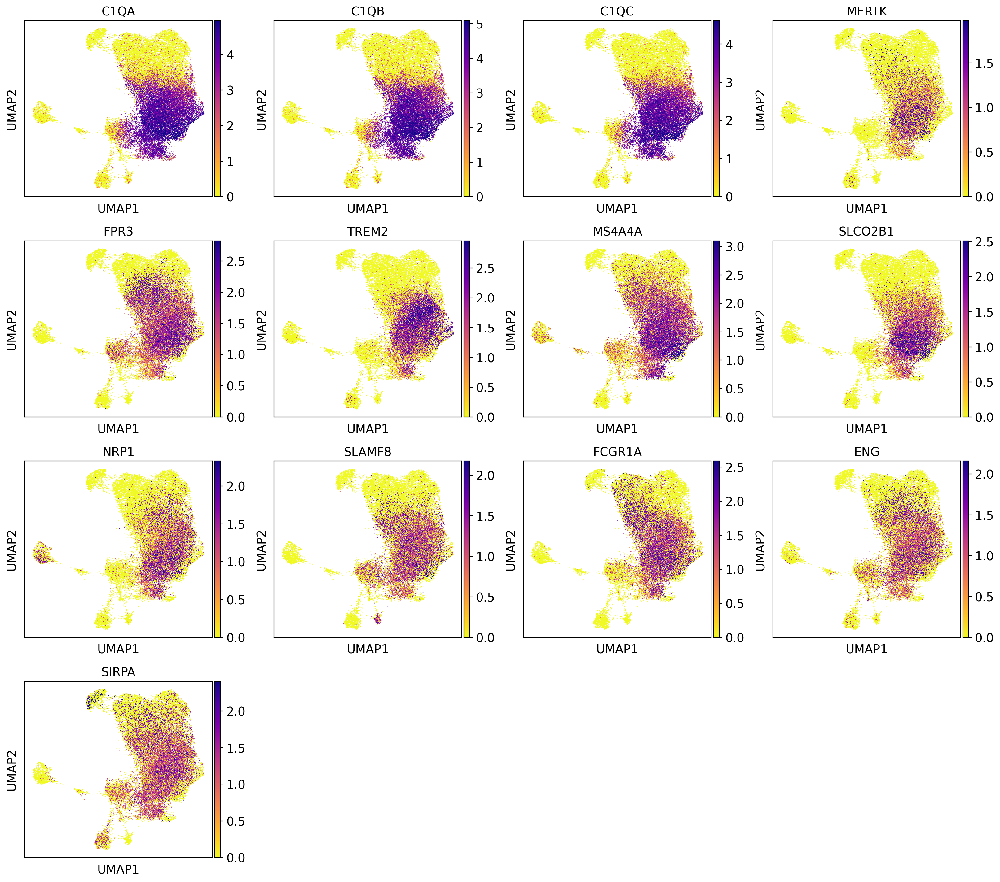

In [9]:
sc.pl.umap(
    adata,
    color=[
        "C1QA",
        "C1QB",
        "C1QC",
        "MERTK",
        "FPR3",
        "TREM2",
        "MS4A4A",
        "SLCO2B1",
        "NRP1",
        "SLAMF8",
        "FCGR1A",
        "ENG",
        "SIRPA",
    ],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    show=True,
    save="C1QC_markers.pdf",
)

#### Barplots chemotreated vs naive in metastasis 

In [29]:
from matplotlib.patches import Rectangle


def proportion_cells_patient(
    adata, groupby_labels, xlabel: str, ylabel: str, plot2save, colors: dict
):  # colors
    # compute proportion of cells within each group
    table2plot = (
        adata.reset_index()
        .groupby(groupby_labels)
        .size()
        .groupby(level=0)
        .apply(lambda x: x * 100 / x.sum())
        .unstack()
    )

    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI
    )  # , figsize=(4, 4))

    print(table2plot)

    table2plot.plot.bar(stacked=True, ax=ax, color=colors.values())  # , color=colors

    ax.set_ylabel(ylabel)
    ax.set_xlabel(xlabel)
    ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd

    labels = list(colors.keys())

    l = [Rectangle((0, 0), 0, 0, color=color) for color in list(colors.values())]

    ax.legend(
        l,
        labels,
        loc="upper left",
        bbox_to_anchor=(1, 0.8),
        facecolor="white",
        edgecolor="white",
        ncol=1,
        borderaxespad=0.0,
        framealpha=0,
        frameon=False,
    )

    plt.savefig(
        plot2save,
        dpi=DPI,
        format="png",
        facecolor="w",
        transparent=True,
        edgecolor="w",
        # orientation='landscape'
    )

    plt.show()

In [30]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata.obs["Annotation_scVI_detailed"].cat.categories.values.tolist(),
        adata.uns["Annotation_scVI_detailed_colors"],
    )
)

Annotation_scVI_detailed   C1QC Mac  FCGR3A Mono  FCN1 Mono  HSP Mono  \
Therapy                                                                 
NAC                       14.760864     2.184996  15.125030  7.234766   
naive                     17.814988     7.951322  12.389057  4.443834   

Annotation_scVI_detailed  IL1B Mac  Myeloid cycling  NLRP3 Mac  Neutrophil  \
Therapy                                                                      
NAC                       3.374605         7.865987   8.934207    5.219714   
naive                     4.019886         5.618080   4.632934    2.558941   

Annotation_scVI_detailed  PLTP LYVE1 Mac   SPP1 Mac      cDC1       cDC2  \
Therapy                                                                    
NAC                             1.747997   9.079874  2.670551  15.294975   
naive                           6.337878  20.261079  0.710648   6.203678   

Annotation_scVI_detailed     migDC       pDC  
Therapy                                   

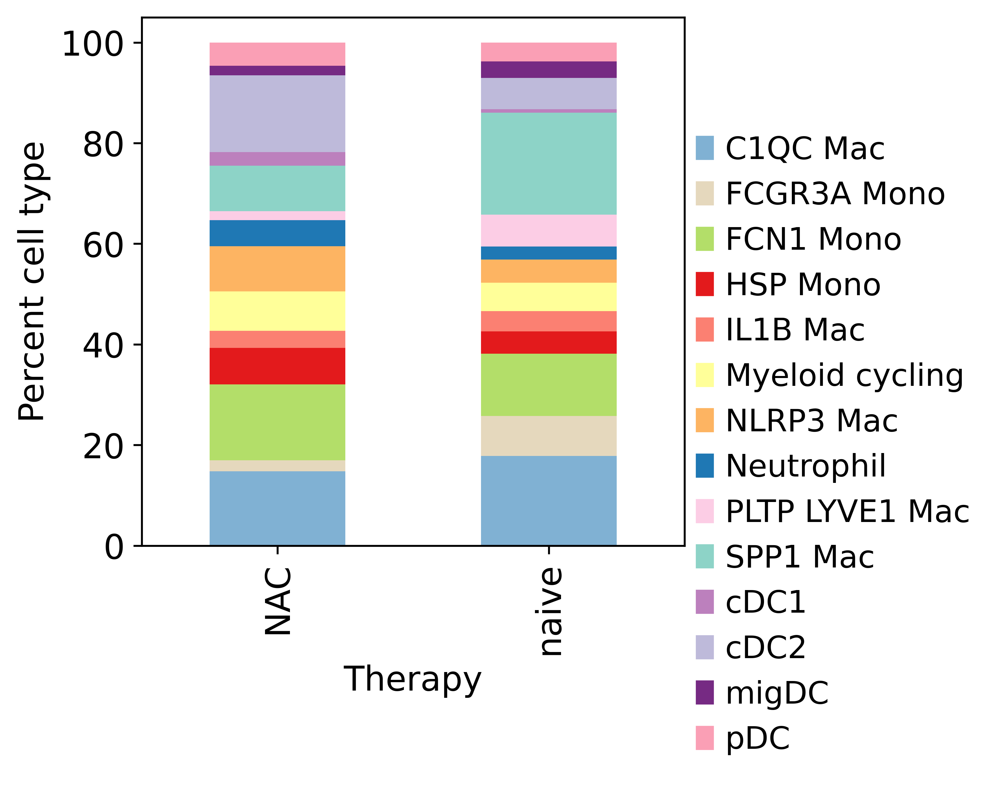

In [31]:
proportion_cells_patient(
    adata.obs,
    groupby_labels=["Therapy", "Annotation_scVI_detailed"],
    xlabel="Therapy",
    ylabel="Percent cell type",
    colors=color_dict,
    plot2save=FIG2SAVE.joinpath("Barplot_therapy_celltypes.png"),
)

### Check scores 

In [5]:
adata = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_Myeloid_final.h5ad")
)

In [6]:
adata.shape

(36906, 2000)

In [7]:
adata.obs.Annotation_scVI_detailed.value_counts()

SPP1 Mac           7017
C1QC Mac           6449
FCN1 Mono          4685
FCGR3A Mono        2697
cDC2               2664
Myeloid cycling    2166
PLTP LYVE1 Mac     2150
NLRP3 Mac          1887
HSP Mono           1755
IL1B Mac           1457
pDC                1423
migDC              1159
Neutrophil         1054
cDC1                343
Name: Annotation_scVI_detailed, dtype: int64

### Score for gene signatures - Score myeloid cells for some pathways/signatures 

* look at singatures M1/M2 from zhang paper 2020 p.30/47

     * M1, "classically activated": CCL5, CCR7, CD40, CD86, CXCL9, CXCL10, CXCL11, IDO1, IL1A, IL1B, IL6, IRF1, IRF5 and KYNU
     * M2, "alternatively activated": CCL4, CCL13, CCL18, CCL20, CCL22, CD276, CLEC7A, CTSA, CTSB, CTSC, CTSD, FN1, IL4R, IRF4, LYVE1, MMP9, MMP14, MMP19, MSR1, TGFB1, TGFB2, TGFB3, TNFSF8, TNFSF12, VEGFA, VEGFB and VEGFC


* proliferation phenotypes proliferation score (Whitfield et al., 2006) from zhang paper 2020 p30/47

        AURKA, BUB1, CCNB1, CCND1, CCNE1, DEK, E2F1, FEN1, FOXM1, H2AFZ, HMGB2, MCM2, MCM3, MCM4, MCM5, MCM6, MKI67, MYBL2, PCNA, PLK1, TOP2A, TYMS and ZWINT

* look at macrophage phenotype signatures from spatiotemporal crc cancer discovery scores see 21598290cd210316-sup-261988_2_supp_7311950_qxkcf0.xlsx in downloads


* zhang 2022 paper Immune phenotypic linkage between colorectal cancer and liver metastasis gives markers for clustering for immune cells 


In [37]:
# Zhang 2022 paper macrophage phenotype
# read excel file from Immune phenotypic linkage between colorectal cancer and liver metastasis
macro_phen_zhang = pd.read_excel(
    "/data/BCI-CRC/nasrine/data/zhang_signatures.xlsx",
    sheet_name="Macrophage_markers",
    skiprows=None,
    header=0,
    dtype=str,
)

368


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


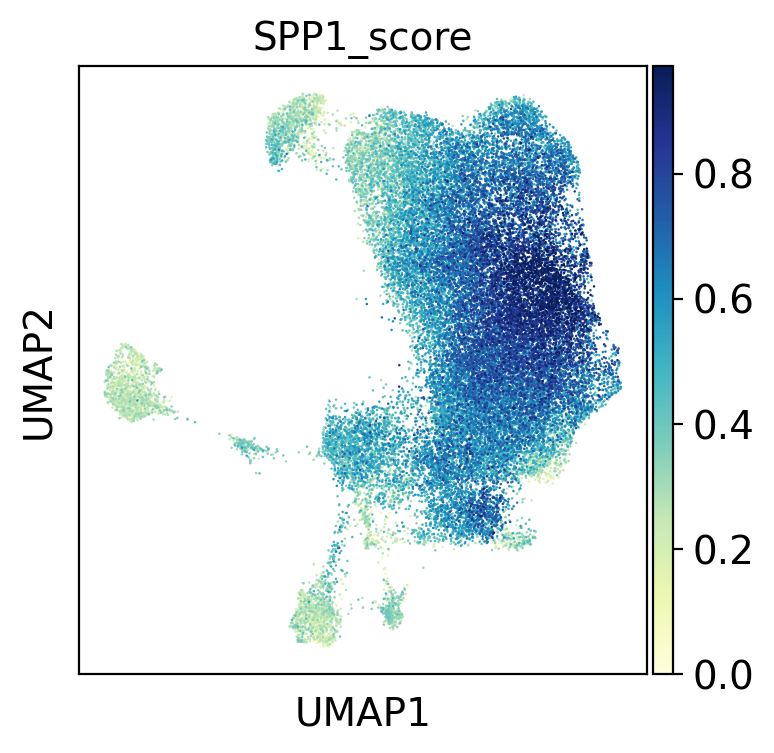

length of gene list in adata.var: 367


In [38]:
SPP1_signature = macro_phen_zhang[
    macro_phen_zhang["Cluster"].str.contains("c54_Mph-SPP1")
]["Gene"].values.tolist()
print(len(SPP1_signature))
SPP1_signature_var = [
    gene for gene in SPP1_signature if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=SPP1_signature_var, score_name="SPP1_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="SPP1_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="myeloid_SPP1_score.pdf",
    color_map="YlGnBu",
    show=True,
)
print("length of gene list in adata.var:", len(SPP1_signature_var))

/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


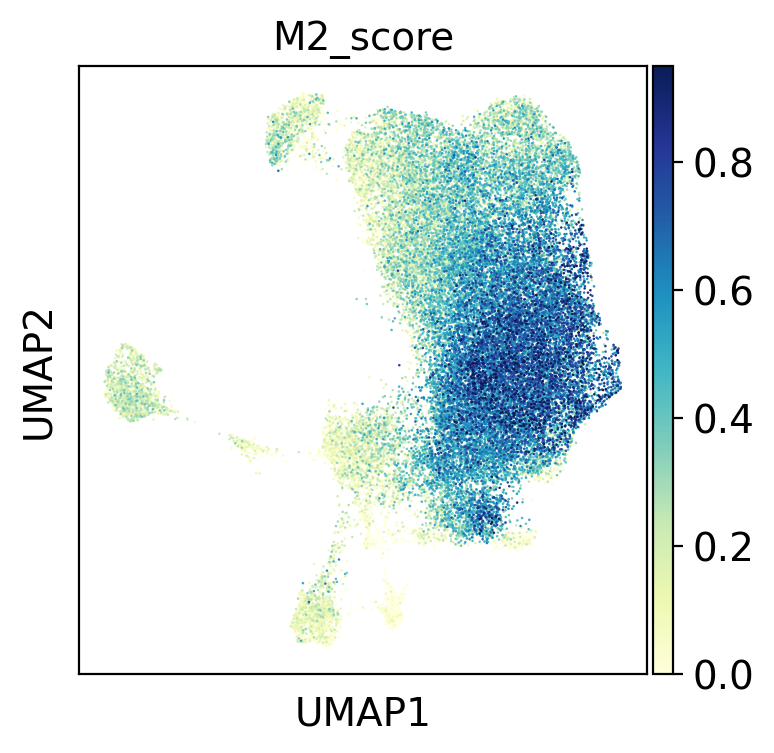

length of gene list in adata.var: 26


In [39]:
M2_phenotype = [
    "CL4",
    "CCL13",
    "CCL18",
    "CCL20",
    "CCL22",
    "CD276",
    "CLEC7A",
    "CTSA",
    "CTSB",
    "CTSC",
    "CTSD",
    "FN1",
    "IL4R",
    "IRF4",
    "LYVE1",
    "MMP9",
    "MMP14",
    "MMP19",
    "MSR1",
    "TGFB1",
    "TGFB2",
    "TGFB3",
    "TNFSF8",
    "TNFSF12",
    "VEGFA",
    "VEGFB",
    "VEGFC",
]
M2_phenotype_var = [
    gene for gene in M2_phenotype if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=M2_phenotype_var, score_name="M2_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="M2_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="myeloid_M2_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(M2_phenotype_var))

/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


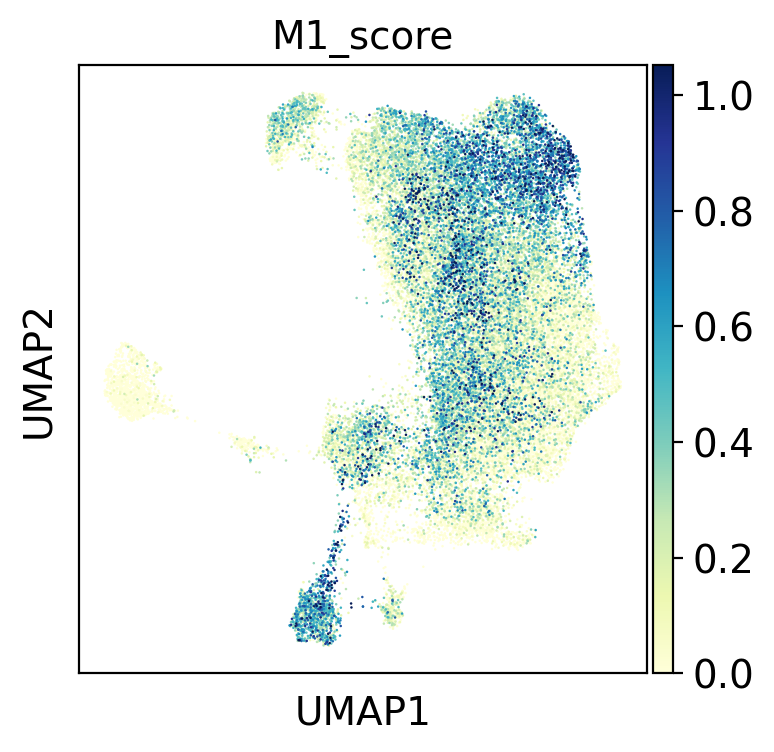

length of gene list in adata.var: 14


In [40]:
M1_phenotype = [
    "CCL5",
    "CCR7",
    "CD40",
    "CD86",
    "CXCL9",
    "CXCL10",
    "CXCL11",
    "IDO1",
    "IL1A",
    "IL1B",
    "IL6",
    "IRF1",
    "IRF5",
    "KYNU",
]
M1_phenotype_var = [
    gene for gene in M1_phenotype if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=M1_phenotype_var, score_name="M1_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="M1_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="myeloid_M1_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(M1_phenotype_var))

In [41]:
# macrophage phenotype
# read excel file
macro_phen = pd.read_excel(
    "/data/BCI-CRC/nasrine/data/Macrophage_signature_spatiotemporal_Wu_Yingcheng_cancer_discovery_2022.xlsx",
    sheet_name="Sheet1",
    skiprows=0,
    header=1,
    dtype=str,
)

In [42]:
# need to set row 'Name' as index to get the process names as keys and then transpose to use fct to_dict()
# drop column 'Source'
macro_phen_dict = (
    macro_phen.set_index("Name").T.drop(labels="Source", axis=0).to_dict(orient="list")
)

200
77


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


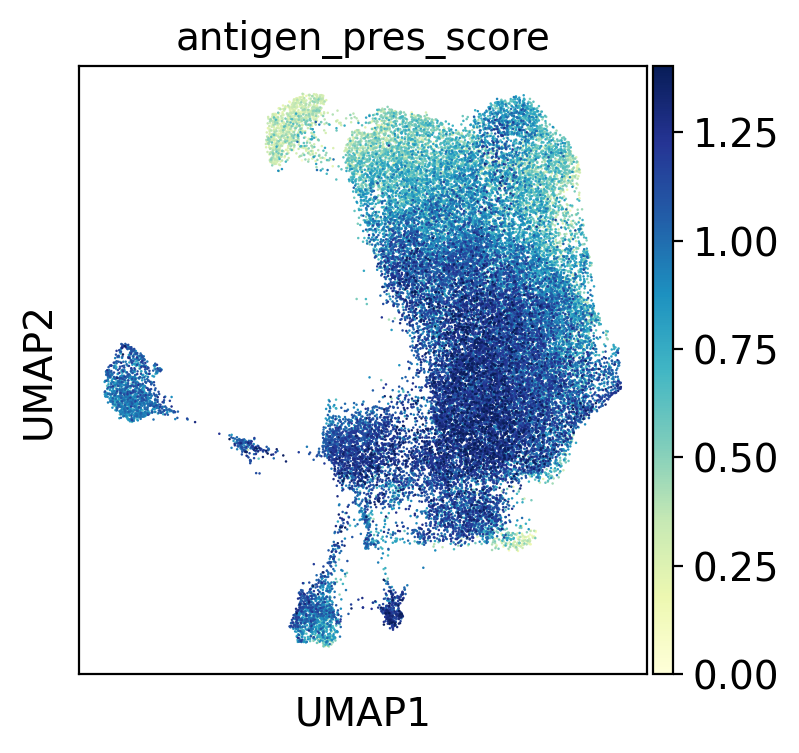

length of gene list in adata.var: 68


In [43]:
print(len(macro_phen_dict["Antigen processing and presentation"]))
antigen_macro = [
    x for x in macro_phen_dict["Antigen processing and presentation"] if str(x) != "nan"
]
print(len(antigen_macro))
antigen_macro_var = [
    gene for gene in antigen_macro if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=antigen_macro_var, score_name="antigen_pres_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="antigen_pres_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="antigen_pres_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(antigen_macro_var))

36


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


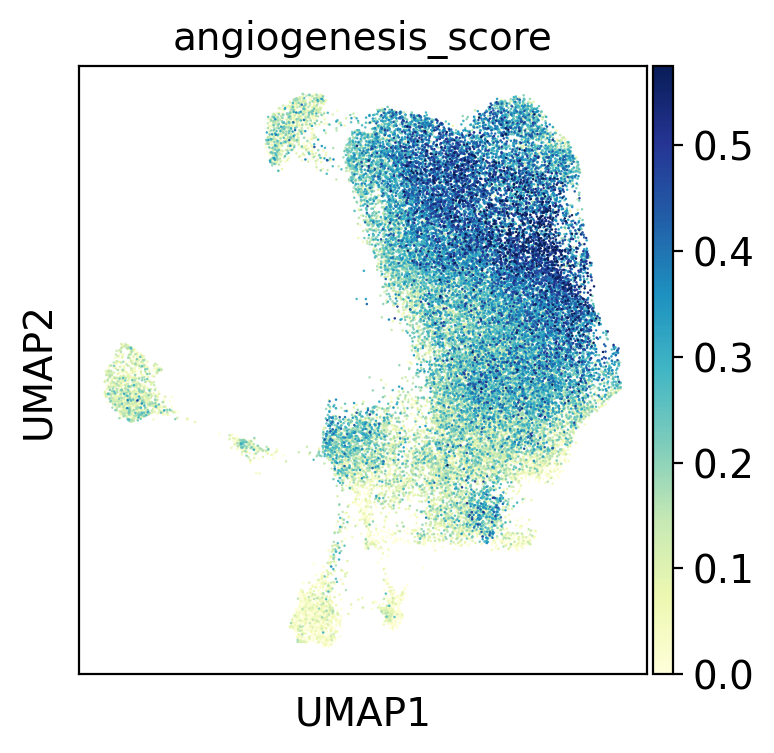

length of gene list in adata.var: 36


In [44]:
angiogen_macro = [x for x in macro_phen_dict["Angiogenesis"] if str(x) != "nan"]
print(len(angiogen_macro))
angiogen_macro_var = [
    gene for gene in angiogen_macro if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=angiogen_macro_var, score_name="angiogenesis_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="angiogenesis_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="angiogenesis_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(angiogen_macro_var))

95


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


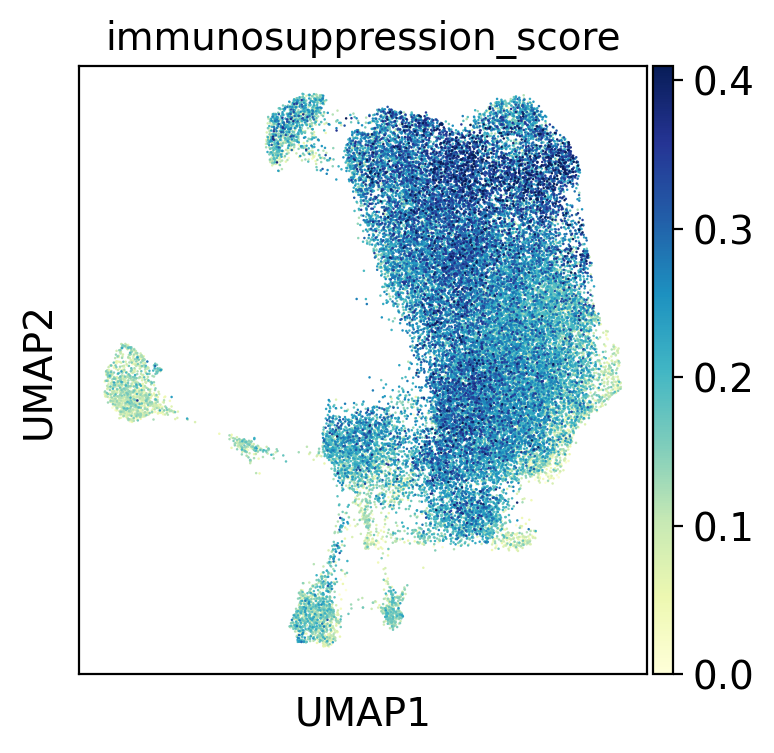

length of gene list in adata.var: 88


In [45]:
suppress_macro = [x for x in macro_phen_dict["Immune suppression"] if str(x) != "nan"]
print(len(suppress_macro))
suppress_macro_var = [
    gene for gene in suppress_macro if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata,
    gene_list=suppress_macro_var,
    score_name="immunosuppression_score",
    use_raw=True,
)
sc.pl.umap(
    adata,
    color="immunosuppression_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="immunosuppression_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(suppress_macro_var))

200


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


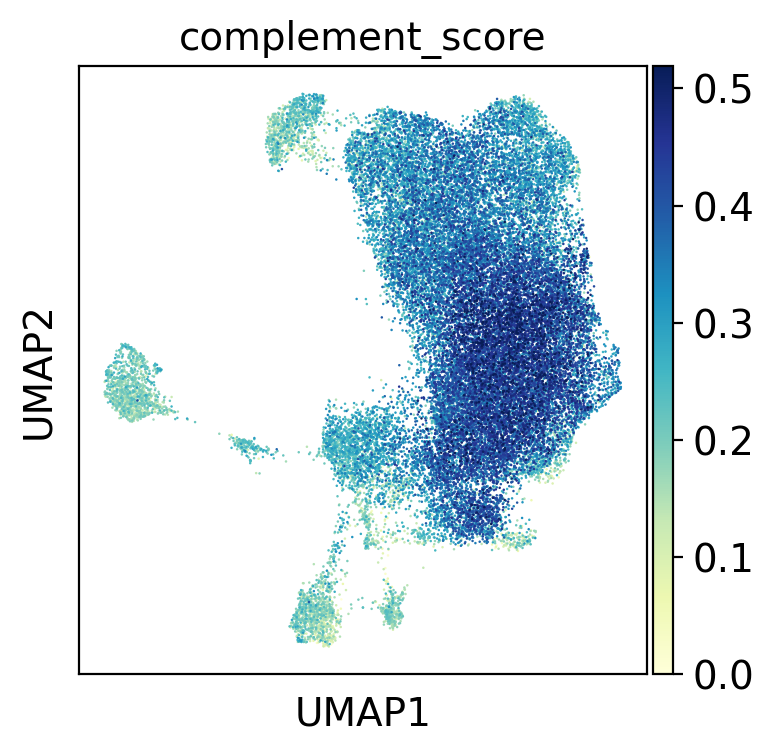

length of gene list in adata.var: 200


In [46]:
complement_macro = [x for x in macro_phen_dict["Complement"] if str(x) != "nan"]
print(len(complement_macro))
complement_macro_var = [
    gene for gene in complement_macro if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=complement_macro_var, score_name="complement_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="complement_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="complement_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(complement_macro_var))

200
188


/data/BCI-CRC/nasrine/anaconda/envs/cell2loc19/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


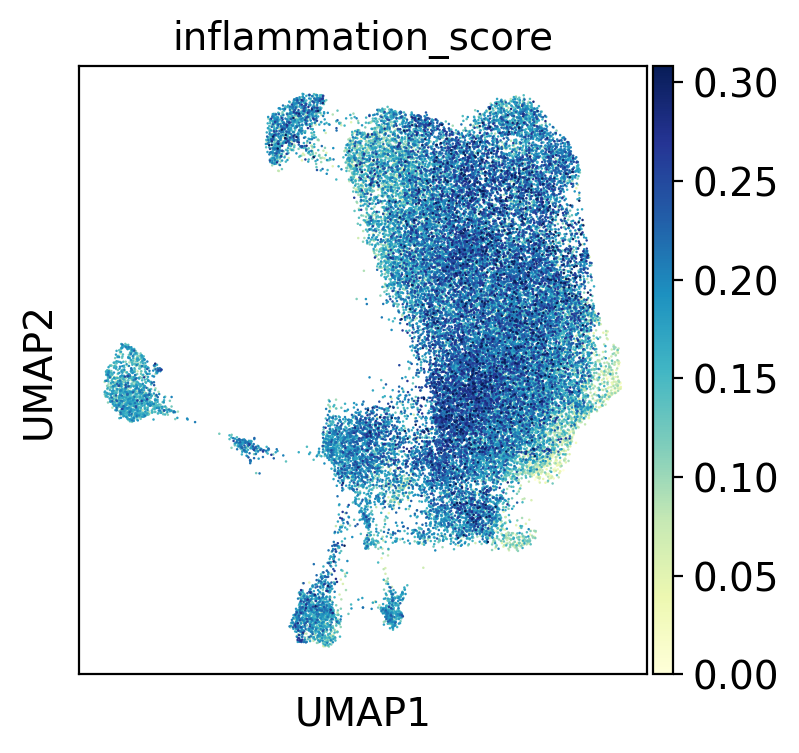

length of gene list in adata.var: 187


In [47]:
print(len(macro_phen_dict["Inflammation"]))
inflamm_macro = [x for x in macro_phen_dict["Inflammation"] if str(x) != "nan"]
print(len(inflamm_macro))
inflamm_macro_var = [
    gene for gene in inflamm_macro if gene in adata.raw.to_adata().var_names
]
sc.tl.score_genes(
    adata, gene_list=inflamm_macro_var, score_name="inflammation_score", use_raw=True
)
sc.pl.umap(
    adata,
    color="inflammation_score",
    vmax="p99",
    use_raw=True,
    vmin=0,
    save="inflammation_score.pdf",
    show=True,
    color_map="YlGnBu",
)
print("length of gene list in adata.var:", len(inflamm_macro_var))